In [1]:
from src.dataloader import ImageDataset
from src.model import Classifier,Config,CNNFeatureExtractor,ClassicalFeatureExtractor,load
from src.trainer import ModelTrainer
from torch.utils.data import random_split,Subset
import torch
import os
import time
import numpy as np
import cv2
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [2]:
config = Config()
BATCH_SIZE = 32
ROOT_DATA_PATH = './dataset/RealWaste'
SEED = 64
EPOCHS = 40
VIS_EVERY=5

In [3]:
config.conv_hidden_dim=3
config.fc_num_layers=2
config.img_size=(128,128)

In [4]:
def plot(datas,labels,xlabel,ylabel,title,figsize=(16,8)):
    plt.figure(figsize=figsize)
    for data,label in zip(datas,labels):
        plt.plot(range(1, len(data)+1), data, label=label)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.show()

In [5]:
dataset = ImageDataset(ROOT_DATA_PATH,config.img_size)

In [6]:
labels = [item['id'] for item in dataset.data]

In [7]:
# Stratified Sampling for train and val
train_idx, validation_idx = train_test_split(np.arange(len(dataset)),
                                             test_size=0.2,
                                             random_state=SEED,
                                             shuffle=True,
                                             stratify=labels)

# Subset dataset for train and val
train_dataset = Subset(dataset, train_idx)
val_dataset = Subset(dataset, validation_idx)

In [8]:
print(train_dataset.dataset.classes)
print(val_dataset.dataset.classes)

['Cardboard', 'Food Organics', 'Glass', 'Metal', 'Miscellaneous Trash', 'Paper', 'Plastic', 'Textile Trash', 'Vegetation']
['Cardboard', 'Food Organics', 'Glass', 'Metal', 'Miscellaneous Trash', 'Paper', 'Plastic', 'Textile Trash', 'Vegetation']


In [9]:
sample = val_dataset.dataset.data[0]
img = cv2.imread(sample['image_path'])
img = cv2.resize(img,(config.img_size))
img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img = img.astype(np.float32) / 255.0

In [10]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [11]:
backbone = CNNFeatureExtractor(config).to(device)
cnnmodel = Classifier(backbone,train_dataset.dataset.classes,config).to(device)

In [ ]:
backbone = CNNFeatureExtractor(config).to(device)
cnnmodel = Classifier(backbone,train_dataset.dataset.classes,config).to(device)

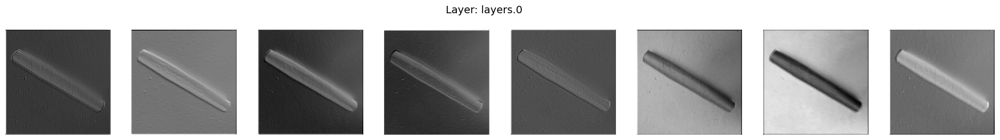

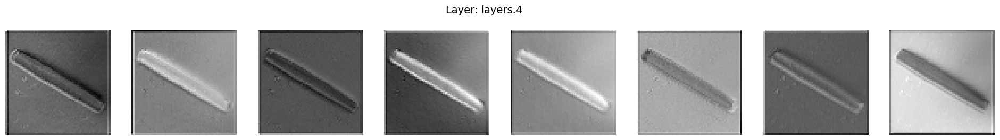

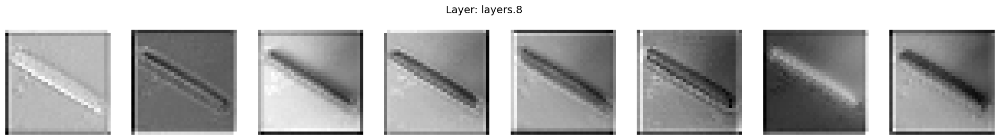

In [ ]:
_ = cnnmodel.backbone.visualize(img)

In [ ]:
trainer = ModelTrainer(cnnmodel,train_dataset,val_dataset,batch_size=BATCH_SIZE,lr=1e-3,device=device,seed=SEED)

In [ ]:
start_time = time.time()

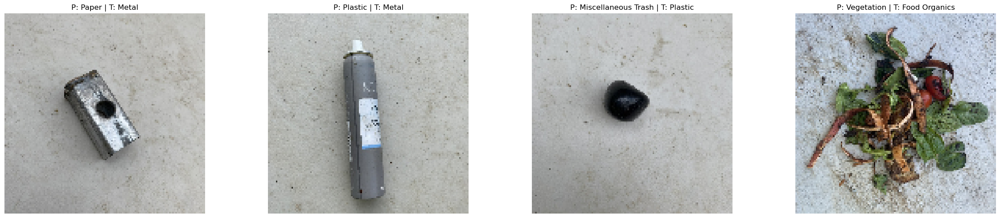

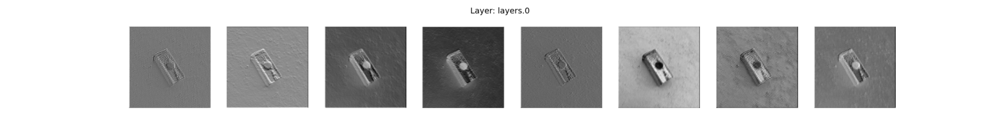

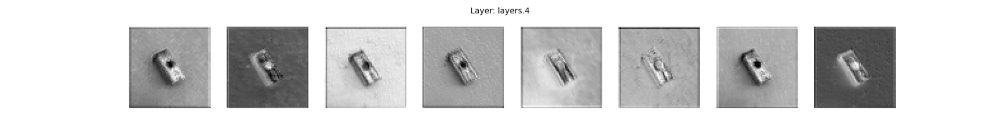

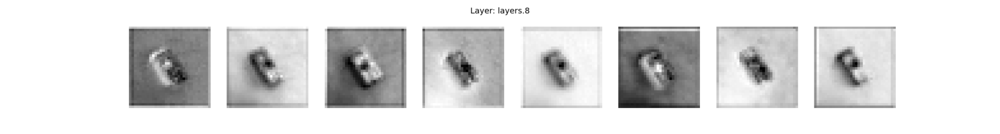

Epoch 1 Train Loss: 1.3658 | Train Acc : 0.5301 | Val Loss : 1.2184 | Val Acc : 0.5794


Epoch 2 Train Loss: 1.0228 | Train Acc : 0.6393 | Val Loss : 1.0931 | Val Acc : 0.6120


Epoch 3 Train Loss: 0.8415 | Train Acc : 0.7085 | Val Loss : 1.0209 | Val Acc : 0.6383


Epoch 4 Train Loss: 0.6966 | Train Acc : 0.7553 | Val Loss : 1.2847 | Val Acc : 0.5647


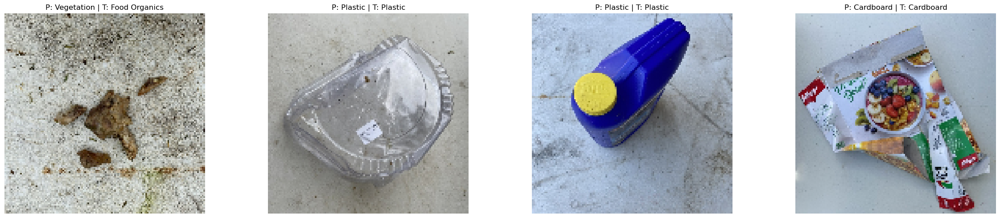

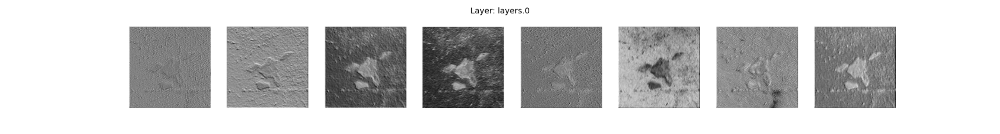

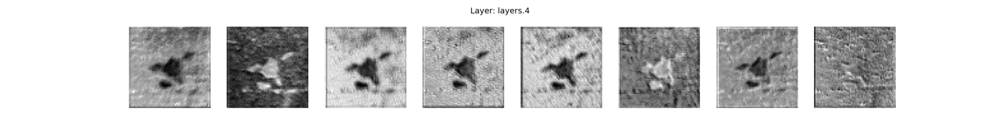

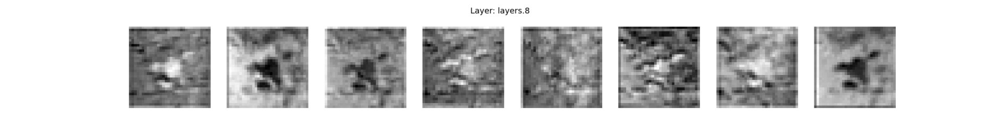

Epoch 5 Train Loss: 0.5687 | Train Acc : 0.8058 | Val Loss : 1.2721 | Val Acc : 0.5773


Epoch 6 Train Loss: 0.4637 | Train Acc : 0.8458 | Val Loss : 0.9470 | Val Acc : 0.6667


Epoch 7 Train Loss: 0.3743 | Train Acc : 0.8740 | Val Loss : 1.2156 | Val Acc : 0.6172


Epoch 8 Train Loss: 0.2769 | Train Acc : 0.9124 | Val Loss : 0.8272 | Val Acc : 0.7150


Epoch 9 Train Loss: 0.2188 | Train Acc : 0.9321 | Val Loss : 1.0048 | Val Acc : 0.6793


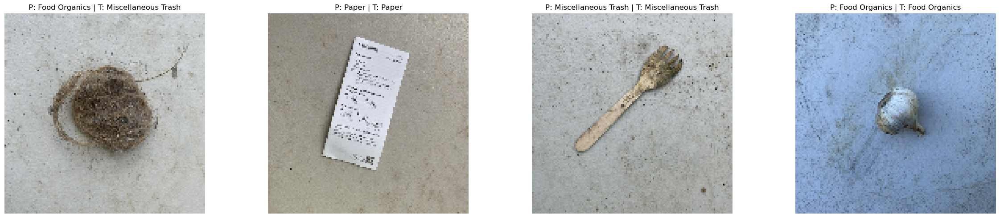

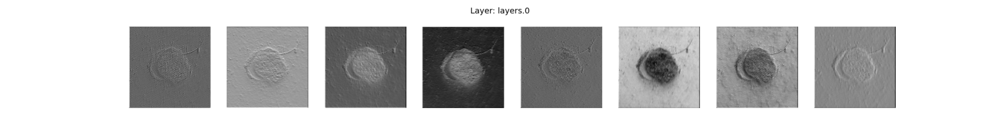

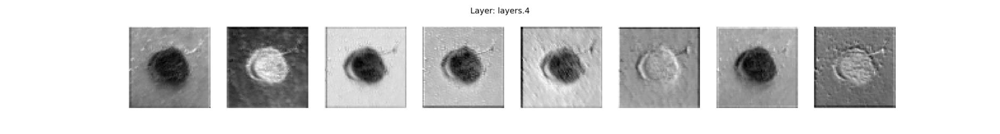

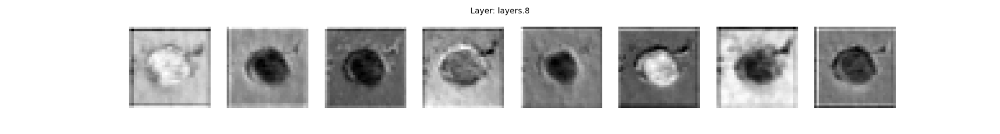

Epoch 10 Train Loss: 0.1797 | Train Acc : 0.9411 | Val Loss : 0.9368 | Val Acc : 0.7066


Epoch 11 Train Loss: 0.1490 | Train Acc : 0.9516 | Val Loss : 0.9577 | Val Acc : 0.7056


Epoch 12 Train Loss: 0.1566 | Train Acc : 0.9476 | Val Loss : 1.5486 | Val Acc : 0.5804


Epoch 13 Train Loss: 0.1783 | Train Acc : 0.9413 | Val Loss : 1.3825 | Val Acc : 0.6193


Epoch 14 Train Loss: 0.1373 | Train Acc : 0.9569 | Val Loss : 1.2432 | Val Acc : 0.6604


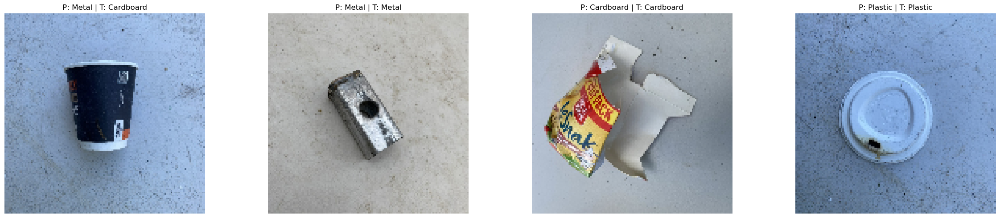

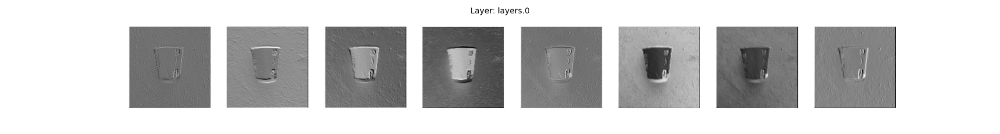

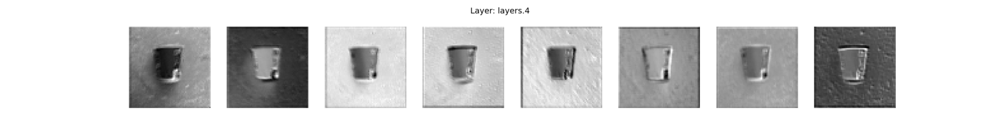

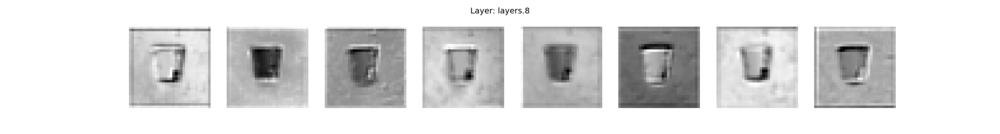

Epoch 15 Train Loss: 0.0879 | Train Acc : 0.9729 | Val Loss : 0.9425 | Val Acc : 0.7234


Epoch 16 Train Loss: 0.1142 | Train Acc : 0.9626 | Val Loss : 0.8993 | Val Acc : 0.7329


Epoch 17 Train Loss: 0.1052 | Train Acc : 0.9655 | Val Loss : 1.3139 | Val Acc : 0.6404


Epoch 18 Train Loss: 0.1004 | Train Acc : 0.9687 | Val Loss : 0.9973 | Val Acc : 0.7287


Epoch 19 Train Loss: 0.0908 | Train Acc : 0.9711 | Val Loss : 0.9070 | Val Acc : 0.7413


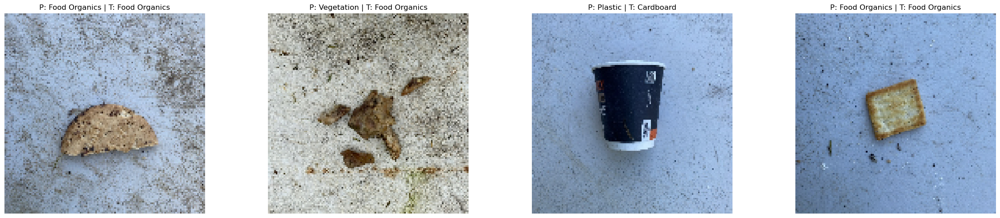

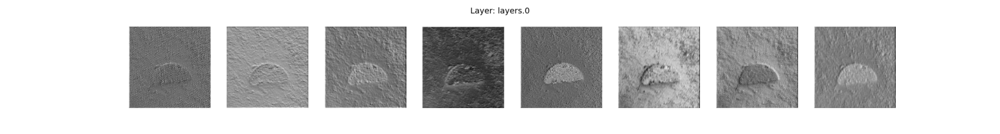

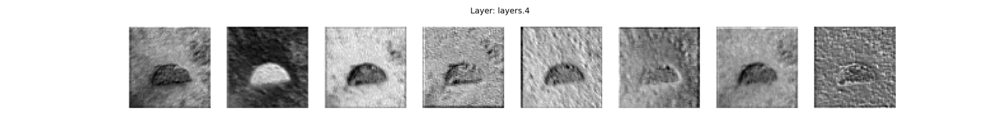

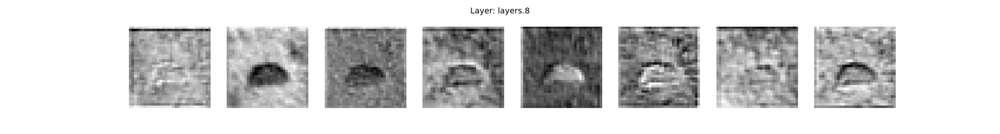

Epoch 20 Train Loss: 0.0931 | Train Acc : 0.9716 | Val Loss : 1.0317 | Val Acc : 0.7150


Epoch 21 Train Loss: 0.0761 | Train Acc : 0.9729 | Val Loss : 1.0193 | Val Acc : 0.7234


Epoch 22 Train Loss: 0.0873 | Train Acc : 0.9690 | Val Loss : 1.6876 | Val Acc : 0.6067


Epoch 23 Train Loss: 0.0890 | Train Acc : 0.9713 | Val Loss : 1.2224 | Val Acc : 0.6677


Epoch 24 Train Loss: 0.0683 | Train Acc : 0.9758 | Val Loss : 1.1227 | Val Acc : 0.6898


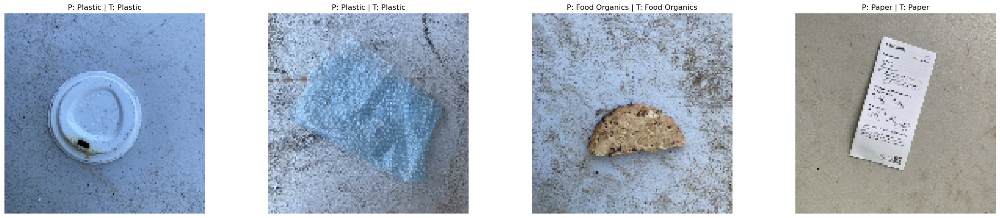

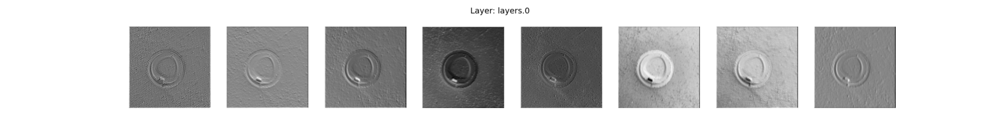

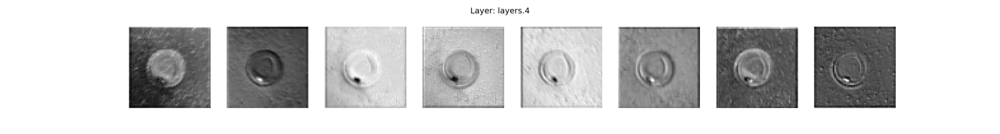

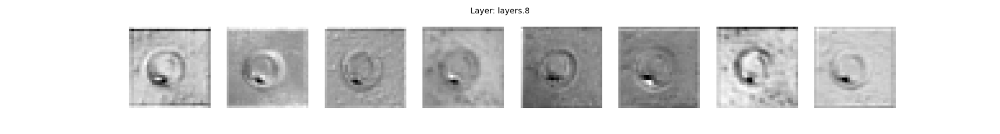

Epoch 25 Train Loss: 0.0506 | Train Acc : 0.9847 | Val Loss : 1.1941 | Val Acc : 0.6993


Epoch 26 Train Loss: 0.0788 | Train Acc : 0.9716 | Val Loss : 1.8720 | Val Acc : 0.6036


Epoch 27 Train Loss: 0.0926 | Train Acc : 0.9703 | Val Loss : 1.1746 | Val Acc : 0.7213


Epoch 28 Train Loss: 0.0829 | Train Acc : 0.9737 | Val Loss : 1.2405 | Val Acc : 0.6835


Epoch 29 Train Loss: 0.0746 | Train Acc : 0.9755 | Val Loss : 1.2562 | Val Acc : 0.6814


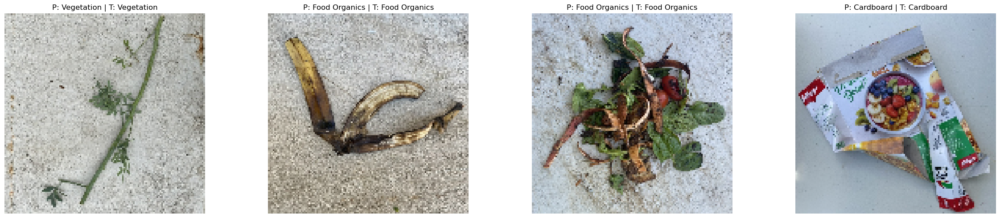

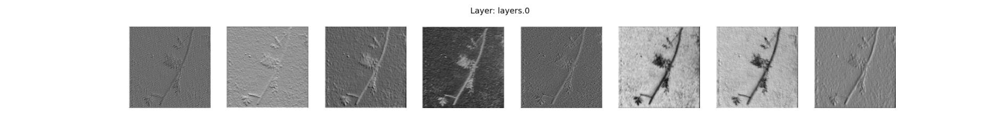

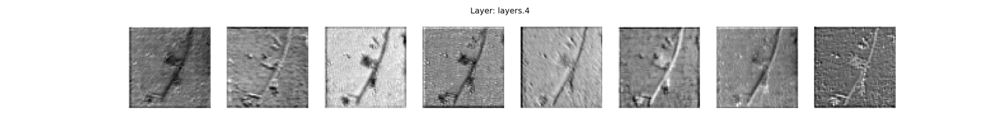

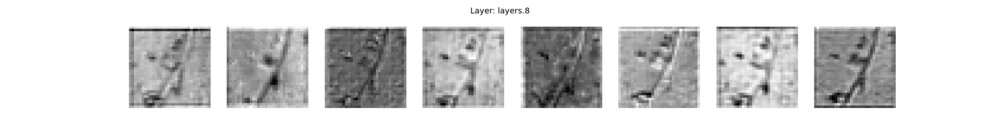

Epoch 30 Train Loss: 0.0642 | Train Acc : 0.9803 | Val Loss : 1.5618 | Val Acc : 0.6299


Epoch 31 Train Loss: 0.0611 | Train Acc : 0.9818 | Val Loss : 1.2065 | Val Acc : 0.6824


Epoch 32 Train Loss: 0.0658 | Train Acc : 0.9766 | Val Loss : 1.2594 | Val Acc : 0.7066


Epoch 33 Train Loss: 0.0790 | Train Acc : 0.9745 | Val Loss : 1.5533 | Val Acc : 0.6309


Epoch 34 Train Loss: 0.0648 | Train Acc : 0.9787 | Val Loss : 1.9604 | Val Acc : 0.5815


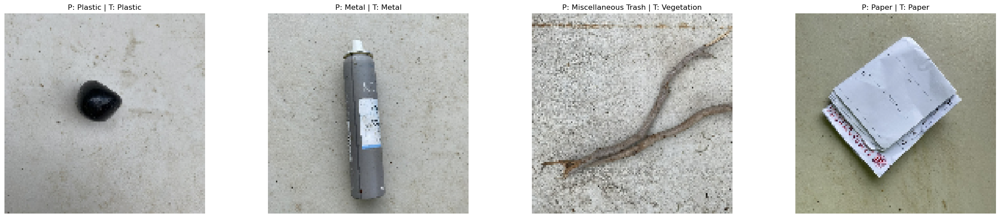

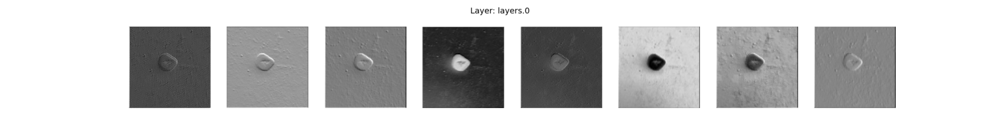

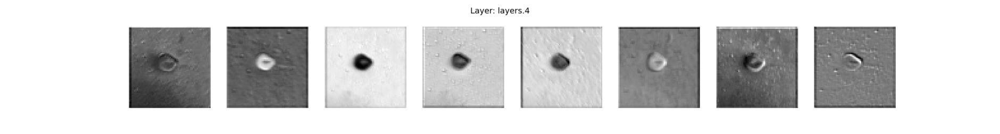

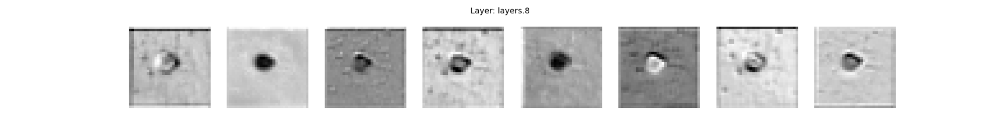

Epoch 35 Train Loss: 0.0575 | Train Acc : 0.9800 | Val Loss : 1.4121 | Val Acc : 0.6782


Epoch 36 Train Loss: 0.0840 | Train Acc : 0.9721 | Val Loss : 1.3147 | Val Acc : 0.6751


Epoch 37 Train Loss: 0.0431 | Train Acc : 0.9871 | Val Loss : 1.9457 | Val Acc : 0.5626


Epoch 38 Train Loss: 0.0441 | Train Acc : 0.9853 | Val Loss : 1.2015 | Val Acc : 0.7329


Epoch 39 Train Loss: 0.0644 | Train Acc : 0.9766 | Val Loss : 1.9531 | Val Acc : 0.5636


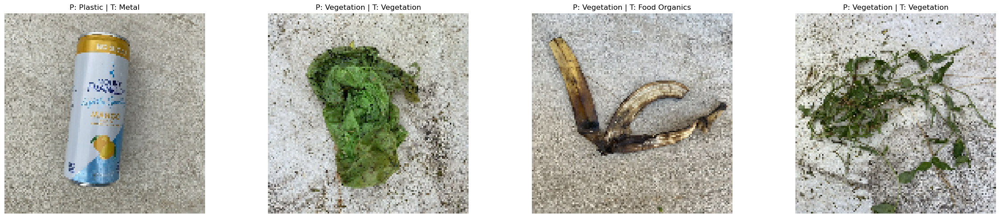

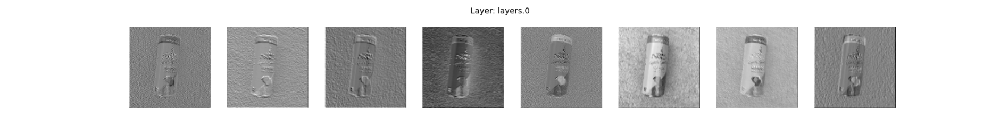

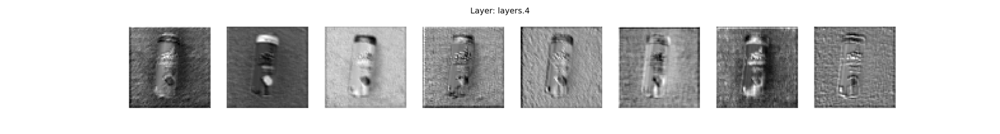

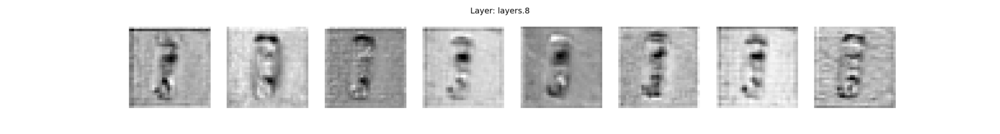

Epoch 40 Train Loss: 0.0550 | Train Acc : 0.9813 | Val Loss : 1.2160 | Val Acc : 0.7035


In [ ]:
for train_loss,train_acc,val_loss,val_acc,fig in trainer.train(epochs=EPOCHS,visualize_every=VIS_EVERY):
    pass

In [ ]:
dt = time.time()-start_time
print(f"Training took {dt} seconds")

Training took 471.7707760334015 seconds


In [ ]:
cnnmodel.save(os.path.join('trained_model','cnn_model.pt'))

Model saved to trained_model\cnn_model.pt


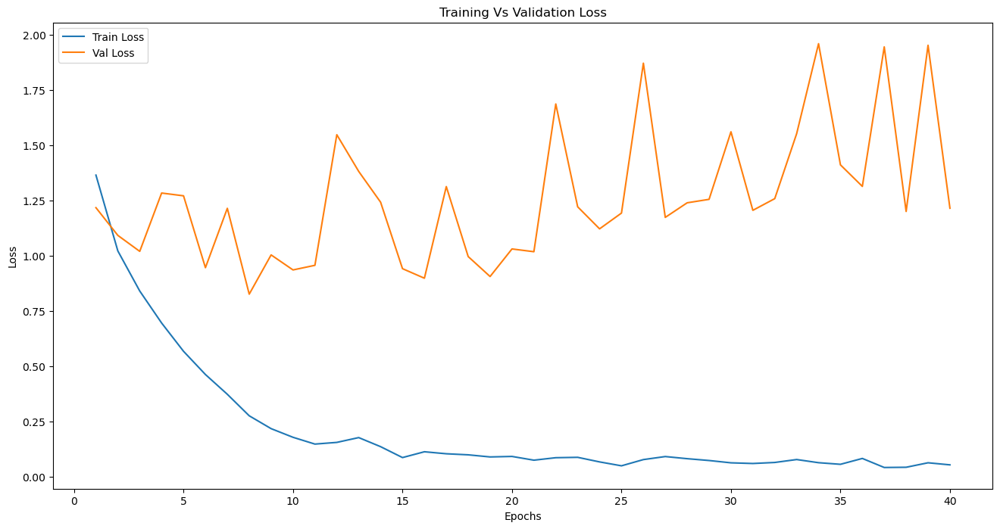

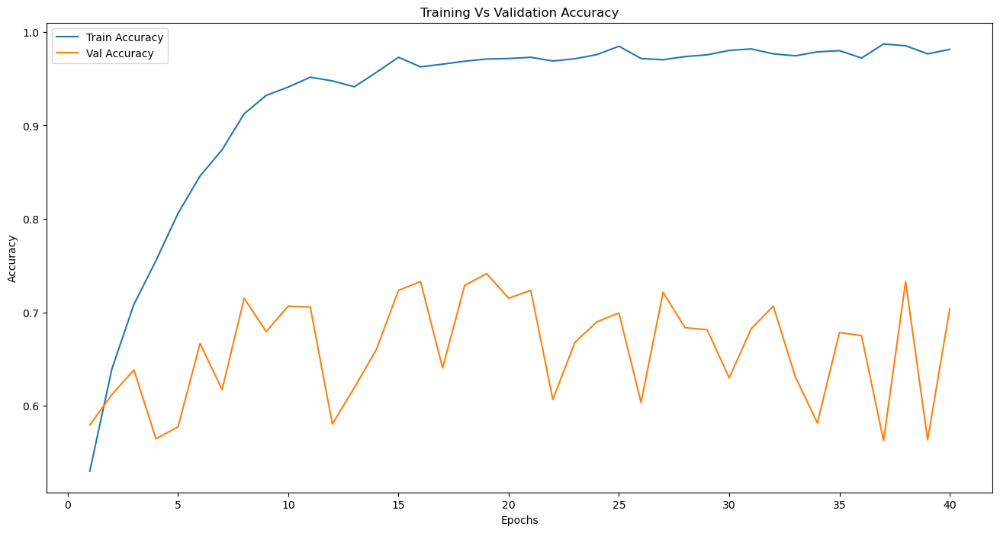

In [ ]:
plot([train_loss,val_loss],['Train Loss','Val Loss'],'Epochs','Loss','Training Vs Validation Loss')
plot([train_acc,val_acc],['Train Accuracy','Val Accuracy'],'Epochs','Accuracy','Training Vs Validation Accuracy')

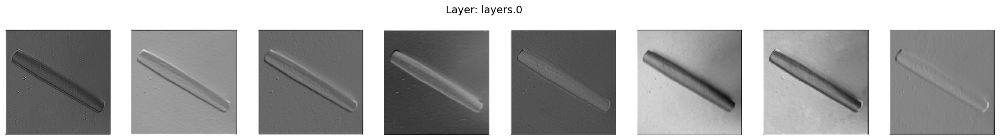

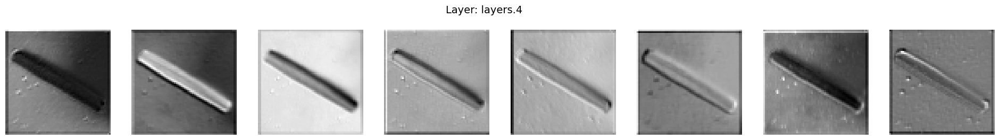

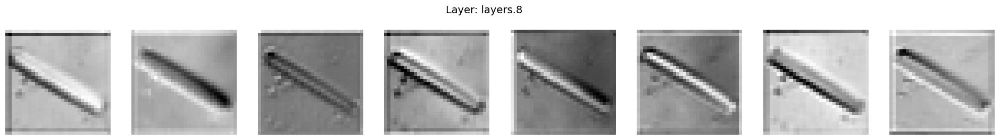

In [ ]:
_ = cnnmodel.backbone.visualize(img)

In [ ]:
classical_config = Config()
classical_config=config
classical_config.classical_downsample=0 # This is to adjust the amount of downsampling

In [ ]:
classical = ClassicalFeatureExtractor(classical_config)

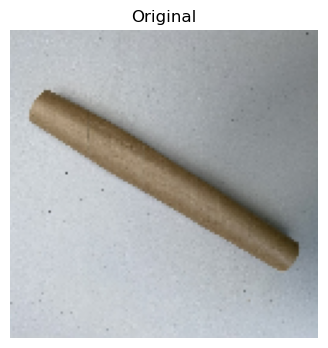

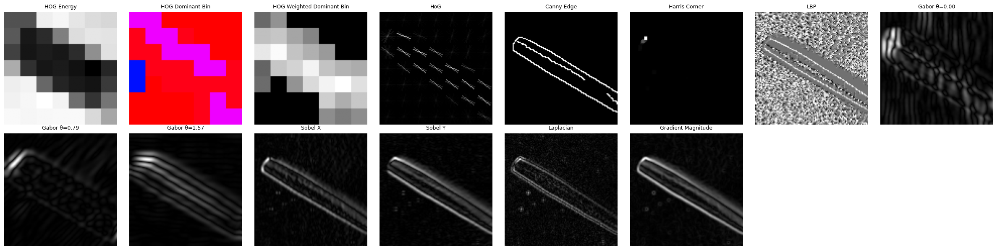

In [ ]:
figs =classical.visualize(img)

In [ ]:
classic_model = Classifier(classical,train_dataset.dataset.classes,classical_config).to(device)

In [ ]:
classic_trainer = ModelTrainer(classic_model,train_dataset,val_dataset,batch_size=BATCH_SIZE,lr=1e-3,device=device,seed=SEED)

In [ ]:
start_time = time.time()

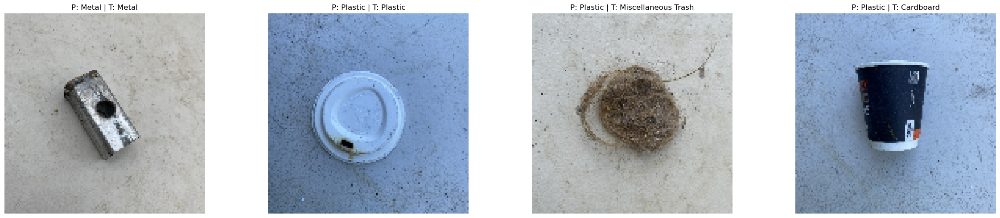

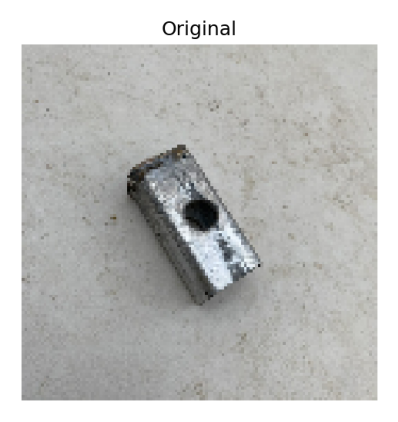

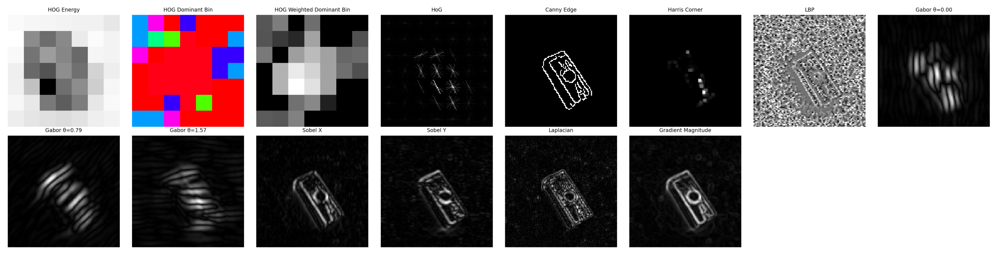

Epoch 1 Train Loss: 1.6399 | Train Acc : 0.4015 | Val Loss : 1.3991 | Val Acc : 0.4942


Epoch 2 Train Loss: 1.1612 | Train Acc : 0.6125 | Val Loss : 1.3747 | Val Acc : 0.5026


Epoch 3 Train Loss: 0.6472 | Train Acc : 0.8143 | Val Loss : 1.5344 | Val Acc : 0.4679


Epoch 4 Train Loss: 0.3023 | Train Acc : 0.9219 | Val Loss : 1.6213 | Val Acc : 0.4606


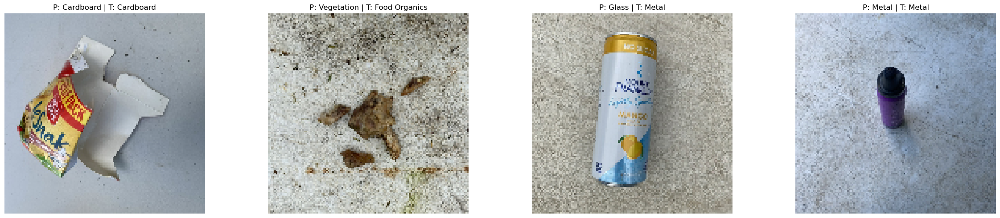

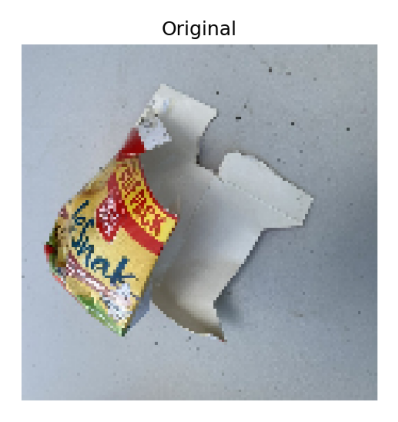

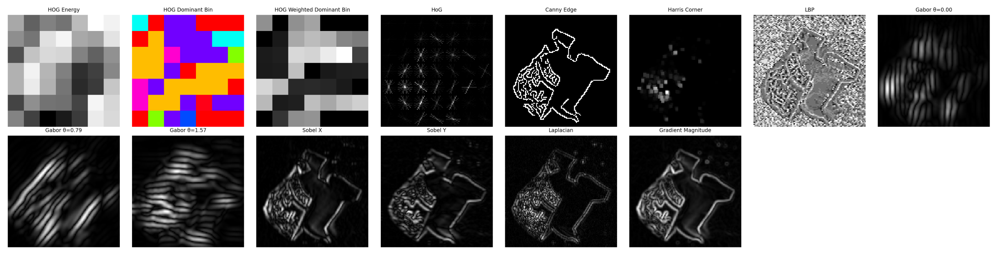

Epoch 5 Train Loss: 0.1682 | Train Acc : 0.9590 | Val Loss : 1.9623 | Val Acc : 0.4437


Epoch 6 Train Loss: 0.1689 | Train Acc : 0.9516 | Val Loss : 1.9475 | Val Acc : 0.4501


Epoch 7 Train Loss: 0.1605 | Train Acc : 0.9511 | Val Loss : 2.4255 | Val Acc : 0.4395


Epoch 8 Train Loss: 0.1558 | Train Acc : 0.9503 | Val Loss : 2.3622 | Val Acc : 0.4196


Epoch 9 Train Loss: 0.1538 | Train Acc : 0.9521 | Val Loss : 3.2167 | Val Acc : 0.3207


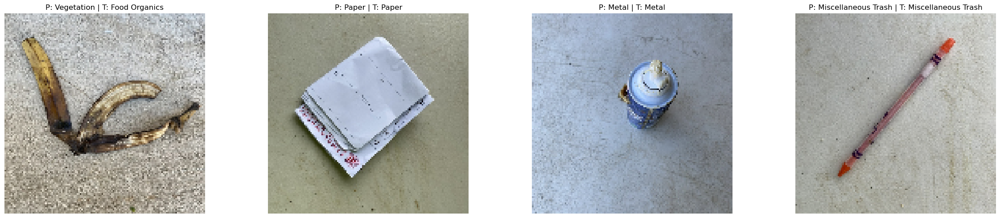

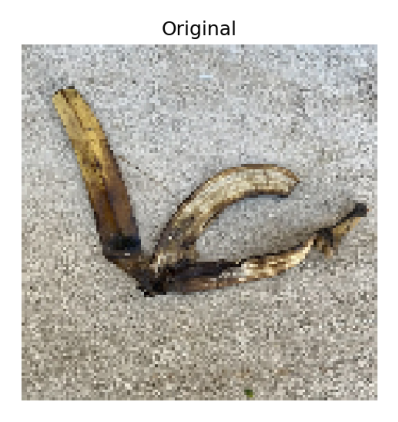

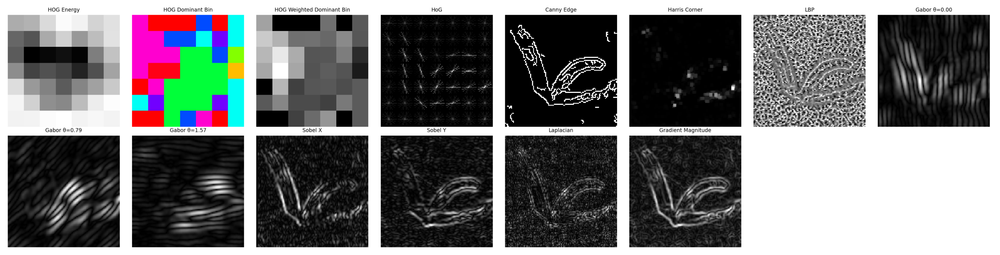

Epoch 10 Train Loss: 0.1302 | Train Acc : 0.9576 | Val Loss : 2.1169 | Val Acc : 0.4679


Epoch 11 Train Loss: 0.1287 | Train Acc : 0.9603 | Val Loss : 2.5074 | Val Acc : 0.4038


Epoch 12 Train Loss: 0.1473 | Train Acc : 0.9526 | Val Loss : 2.1368 | Val Acc : 0.4564


Epoch 13 Train Loss: 0.1480 | Train Acc : 0.9479 | Val Loss : 2.3093 | Val Acc : 0.4574


Epoch 14 Train Loss: 0.1351 | Train Acc : 0.9545 | Val Loss : 2.5273 | Val Acc : 0.4490


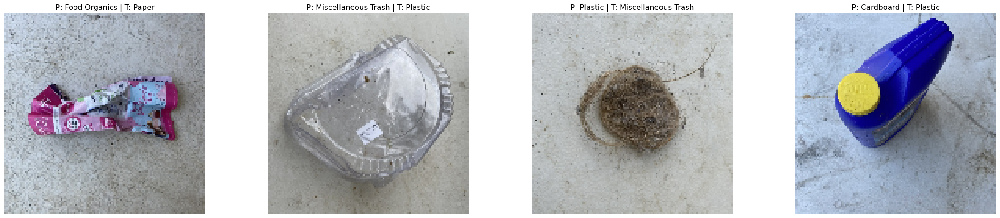

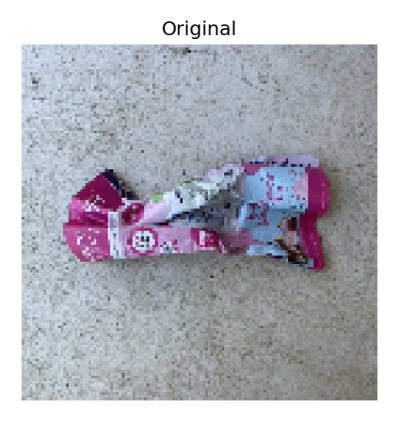

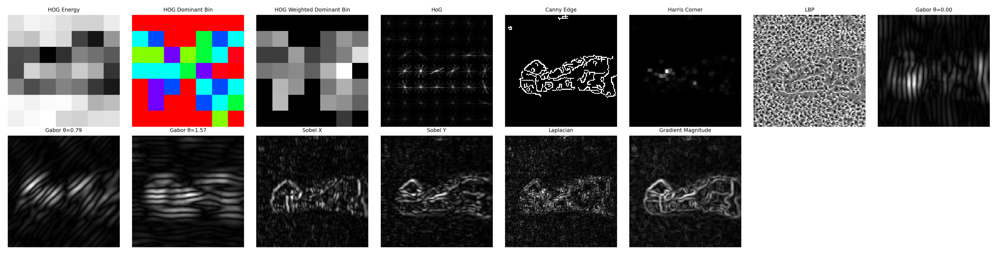

Epoch 15 Train Loss: 0.1012 | Train Acc : 0.9684 | Val Loss : 2.0334 | Val Acc : 0.4448


Epoch 16 Train Loss: 0.1219 | Train Acc : 0.9608 | Val Loss : 2.4190 | Val Acc : 0.4574


Epoch 17 Train Loss: 0.1232 | Train Acc : 0.9616 | Val Loss : 2.8103 | Val Acc : 0.4175


Epoch 18 Train Loss: 0.1089 | Train Acc : 0.9671 | Val Loss : 2.7570 | Val Acc : 0.4753


Epoch 19 Train Loss: 0.1103 | Train Acc : 0.9629 | Val Loss : 3.2209 | Val Acc : 0.4111


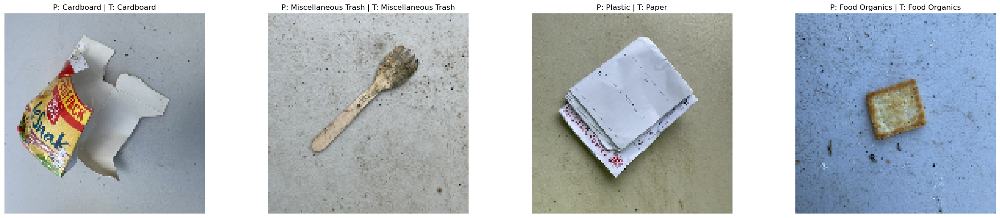

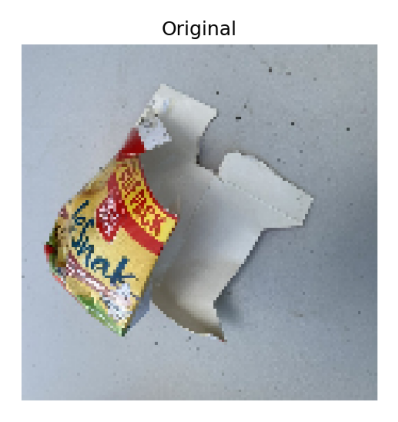

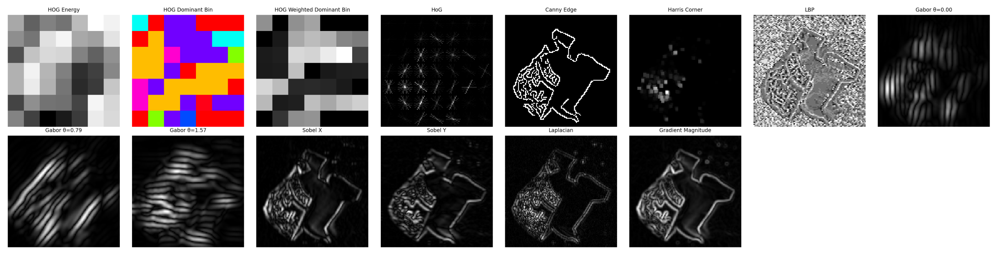

Epoch 20 Train Loss: 0.1529 | Train Acc : 0.9508 | Val Loss : 2.1699 | Val Acc : 0.5037


Epoch 21 Train Loss: 0.1301 | Train Acc : 0.9571 | Val Loss : 3.0337 | Val Acc : 0.3638


Epoch 22 Train Loss: 0.1398 | Train Acc : 0.9545 | Val Loss : 2.4468 | Val Acc : 0.4490


Epoch 23 Train Loss: 0.1225 | Train Acc : 0.9566 | Val Loss : 2.3576 | Val Acc : 0.4679


Epoch 24 Train Loss: 0.1230 | Train Acc : 0.9600 | Val Loss : 2.8909 | Val Acc : 0.4332


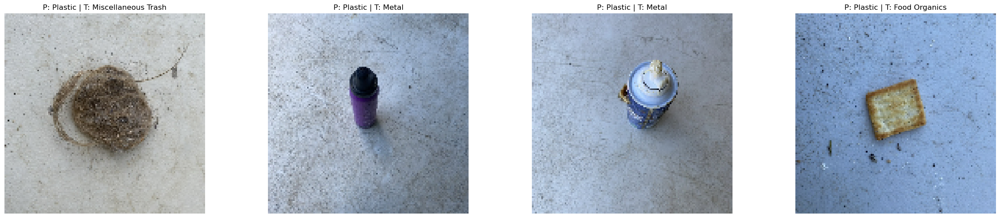

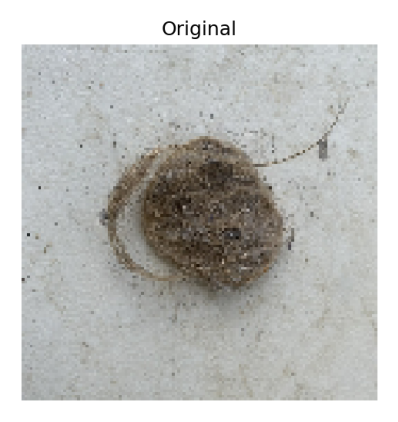

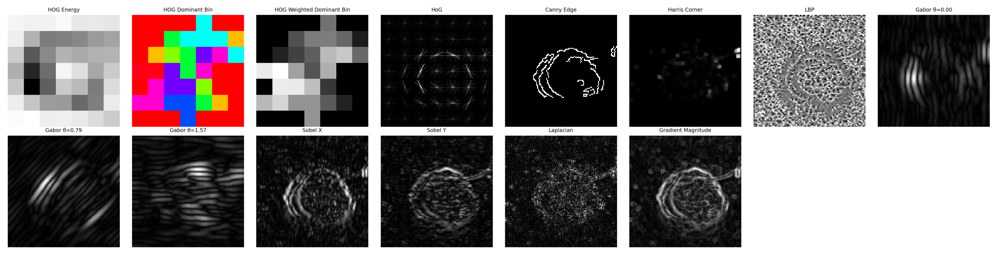

Epoch 25 Train Loss: 0.0982 | Train Acc : 0.9684 | Val Loss : 2.4690 | Val Acc : 0.4564


Epoch 26 Train Loss: 0.1433 | Train Acc : 0.9519 | Val Loss : 2.5469 | Val Acc : 0.4385


Epoch 27 Train Loss: 0.1618 | Train Acc : 0.9461 | Val Loss : 2.5922 | Val Acc : 0.4448


Epoch 28 Train Loss: 0.1332 | Train Acc : 0.9547 | Val Loss : 2.9030 | Val Acc : 0.4122


Epoch 29 Train Loss: 0.1206 | Train Acc : 0.9613 | Val Loss : 2.3801 | Val Acc : 0.4479


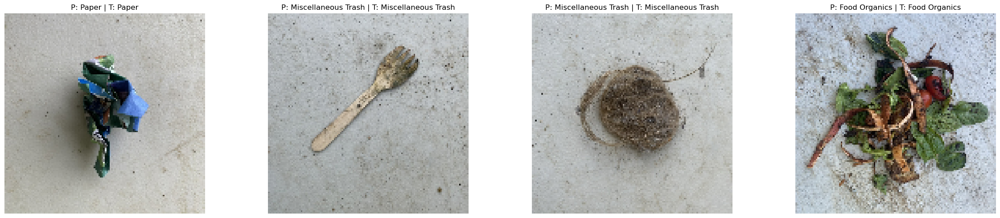

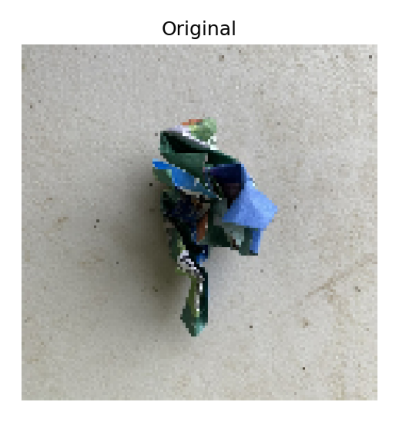

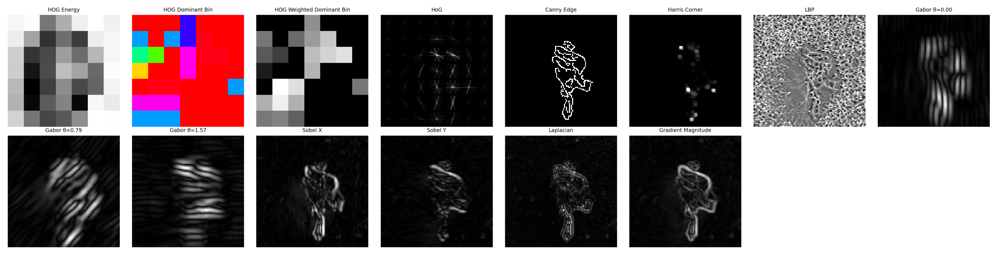

Epoch 30 Train Loss: 0.0782 | Train Acc : 0.9737 | Val Loss : 2.5230 | Val Acc : 0.4280


Epoch 31 Train Loss: 0.1036 | Train Acc : 0.9642 | Val Loss : 3.1786 | Val Acc : 0.4185


Epoch 32 Train Loss: 0.1443 | Train Acc : 0.9492 | Val Loss : 2.6874 | Val Acc : 0.4490


Epoch 33 Train Loss: 0.1618 | Train Acc : 0.9442 | Val Loss : 2.5216 | Val Acc : 0.4332


Epoch 34 Train Loss: 0.1200 | Train Acc : 0.9584 | Val Loss : 2.5000 | Val Acc : 0.4627


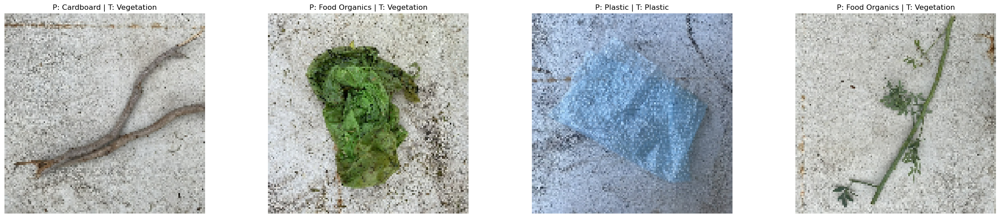

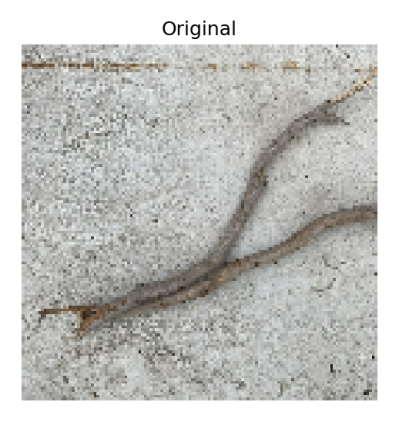

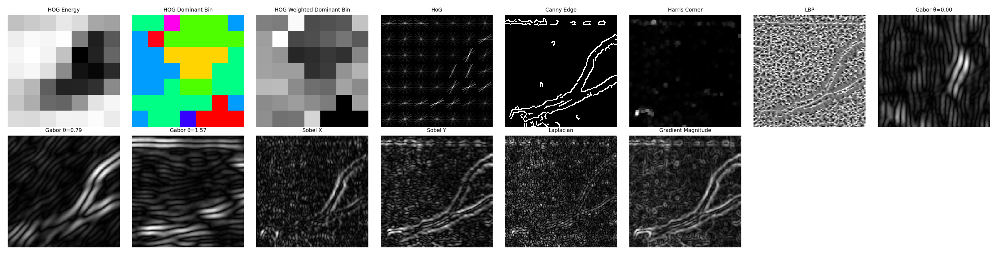

Epoch 35 Train Loss: 0.1255 | Train Acc : 0.9595 | Val Loss : 2.6044 | Val Acc : 0.4132


Epoch 36 Train Loss: 0.0991 | Train Acc : 0.9663 | Val Loss : 2.8161 | Val Acc : 0.4143


Epoch 37 Train Loss: 0.0961 | Train Acc : 0.9671 | Val Loss : 2.7748 | Val Acc : 0.4227


Epoch 38 Train Loss: 0.1269 | Train Acc : 0.9592 | Val Loss : 2.3619 | Val Acc : 0.4690


Epoch 39 Train Loss: 0.1261 | Train Acc : 0.9563 | Val Loss : 3.3988 | Val Acc : 0.3870


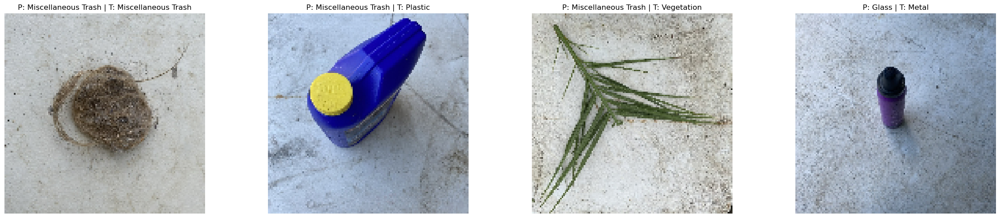

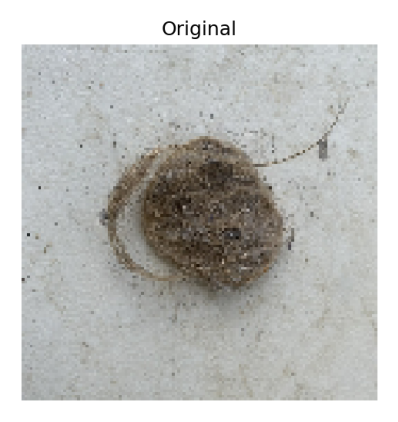

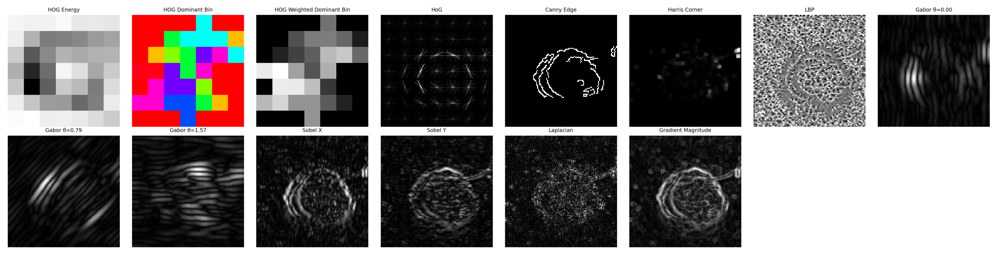

Epoch 40 Train Loss: 0.1648 | Train Acc : 0.9461 | Val Loss : 2.6568 | Val Acc : 0.4343


In [ ]:
for train_loss,train_acc,val_loss,val_acc,fig in classic_trainer.train(epochs=EPOCHS,visualize_every=VIS_EVERY):
    pass

In [ ]:
dt = time.time()-start_time
print(f"Training took {dt} seconds")

Training took 2315.09757232666 seconds


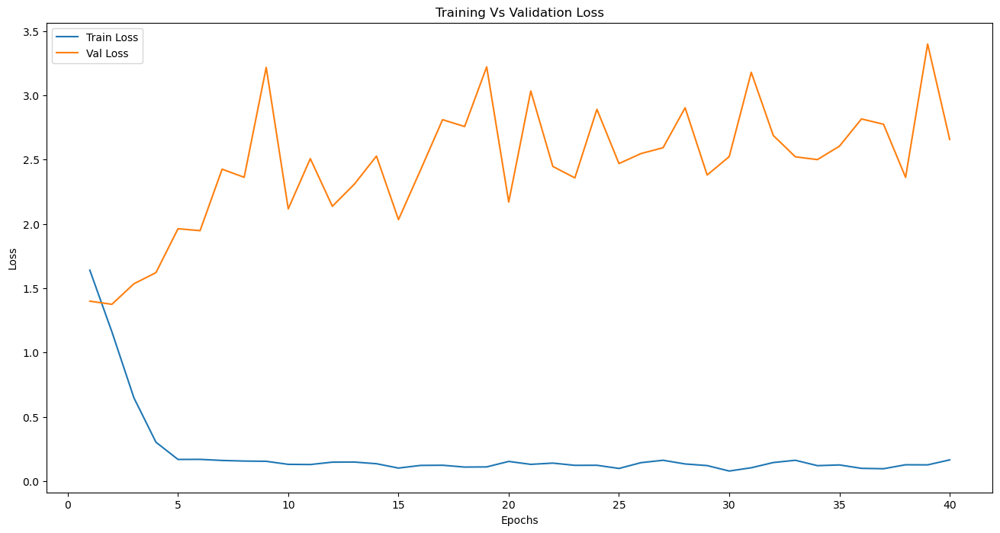

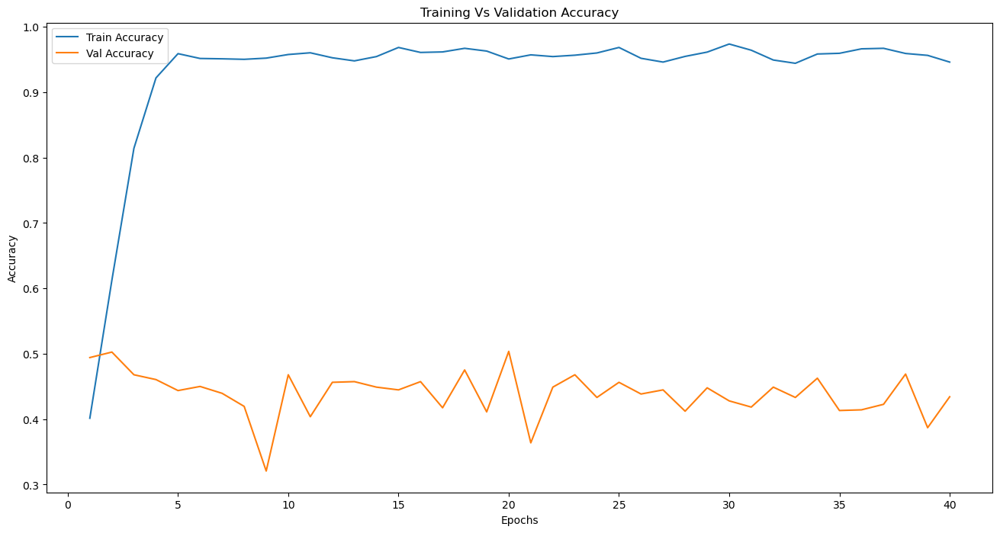

In [ ]:
plot([train_loss,val_loss],['Train Loss','Val Loss'],'Epochs','Loss','Training Vs Validation Loss')
plot([train_acc,val_acc],['Train Accuracy','Val Accuracy'],'Epochs','Accuracy','Training Vs Validation Accuracy')

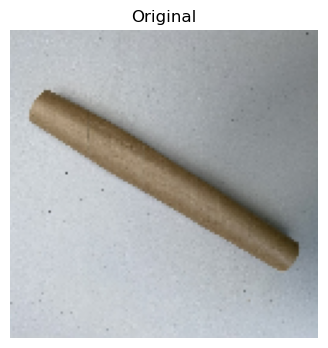

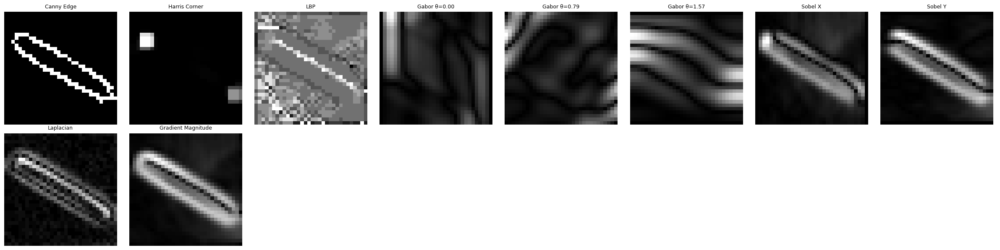

In [ ]:
classical_config = Config()
classical_config=config
classical_config.classical_downsample=2
classical_config.fc_num_layers=1
classical = ClassicalFeatureExtractor(classical_config)
classic_model = Classifier(classical,train_dataset.dataset.classes,classical_config).to(device)
_ =classical.visualize(img)

In [ ]:
classic_trainer = ModelTrainer(classic_model,train_dataset,val_dataset,batch_size=BATCH_SIZE,lr=1e-3,device=device,seed=SEED)

In [ ]:
start_time = time.time()

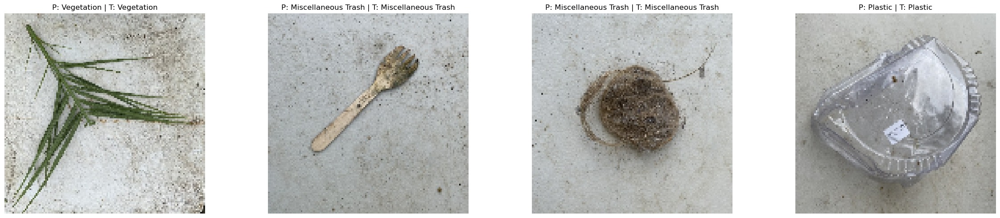

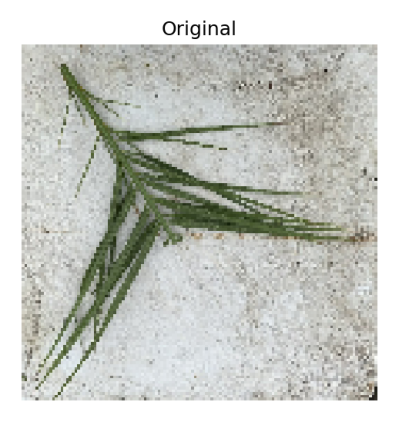

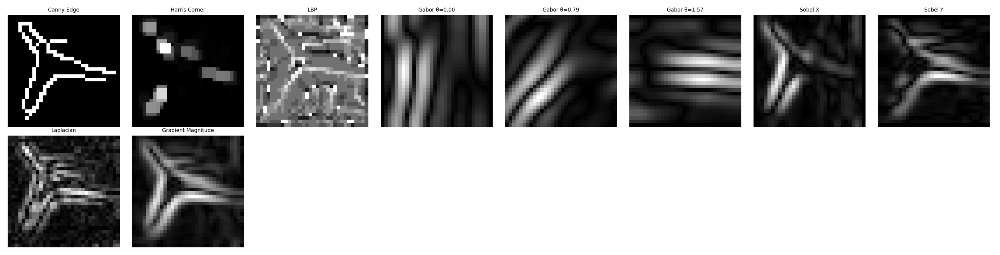

Epoch 1 Train Loss: 1.7889 | Train Acc : 0.3533 | Val Loss : 1.6129 | Val Acc : 0.4301


Epoch 2 Train Loss: 1.2666 | Train Acc : 0.5806 | Val Loss : 1.5608 | Val Acc : 0.4501


Epoch 3 Train Loss: 0.8747 | Train Acc : 0.7340 | Val Loss : 1.5477 | Val Acc : 0.4564


Epoch 4 Train Loss: 0.5817 | Train Acc : 0.8337 | Val Loss : 1.6050 | Val Acc : 0.4763


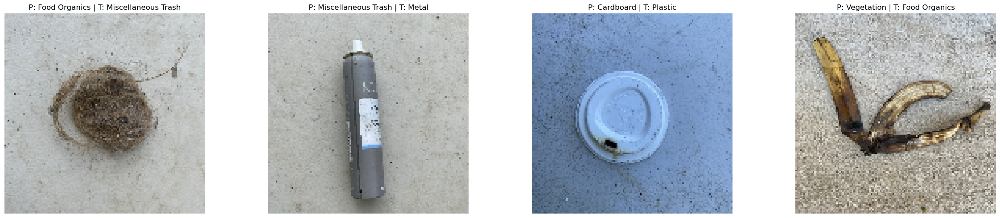

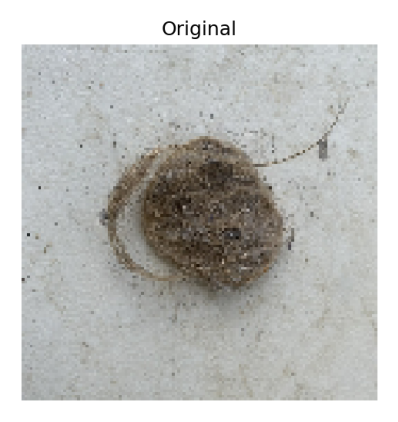

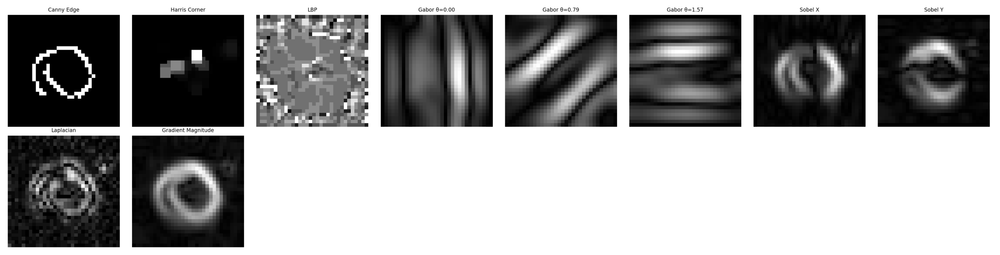

Epoch 5 Train Loss: 0.3295 | Train Acc : 0.9245 | Val Loss : 1.7320 | Val Acc : 0.4248


Epoch 6 Train Loss: 0.1937 | Train Acc : 0.9666 | Val Loss : 1.9226 | Val Acc : 0.4154


Epoch 7 Train Loss: 0.1348 | Train Acc : 0.9774 | Val Loss : 1.9100 | Val Acc : 0.4416


Epoch 8 Train Loss: 0.1067 | Train Acc : 0.9813 | Val Loss : 2.1382 | Val Acc : 0.4406


Epoch 9 Train Loss: 0.0737 | Train Acc : 0.9921 | Val Loss : 2.1368 | Val Acc : 0.4490


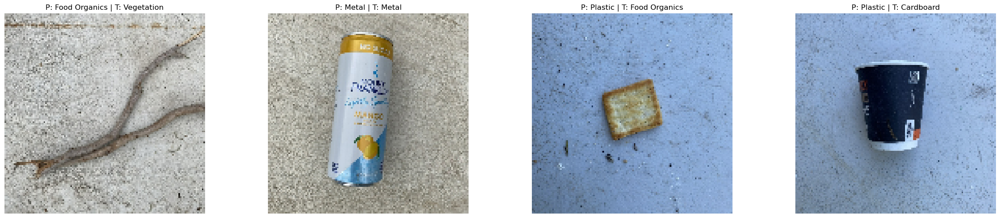

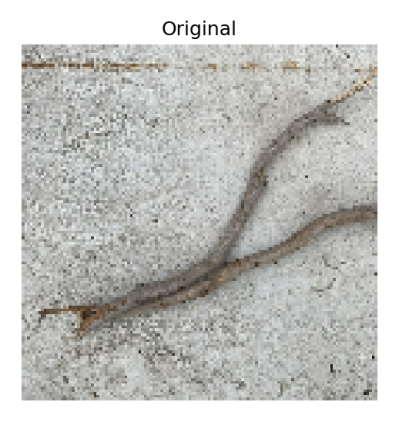

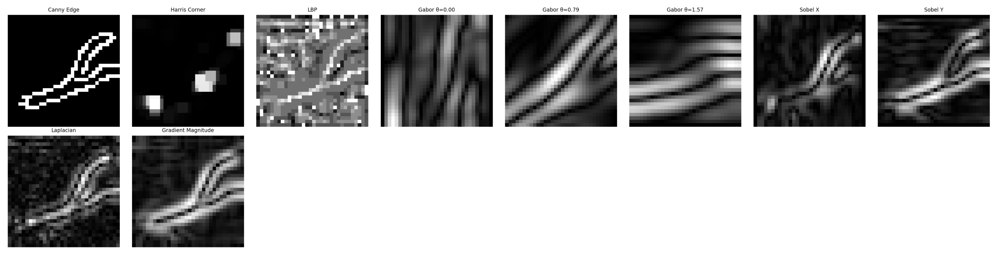

Epoch 10 Train Loss: 0.0472 | Train Acc : 0.9953 | Val Loss : 2.1247 | Val Acc : 0.4564


Epoch 11 Train Loss: 0.0479 | Train Acc : 0.9950 | Val Loss : 2.2215 | Val Acc : 0.4479


Epoch 12 Train Loss: 0.0455 | Train Acc : 0.9945 | Val Loss : 2.1702 | Val Acc : 0.4406


Epoch 13 Train Loss: 0.0940 | Train Acc : 0.9753 | Val Loss : 2.3412 | Val Acc : 0.4448


Epoch 14 Train Loss: 0.1555 | Train Acc : 0.9574 | Val Loss : 2.2976 | Val Acc : 0.4227


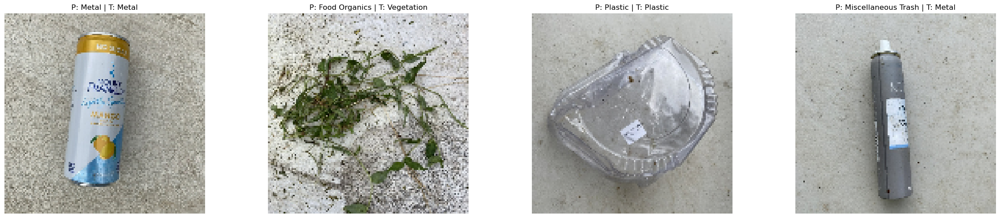

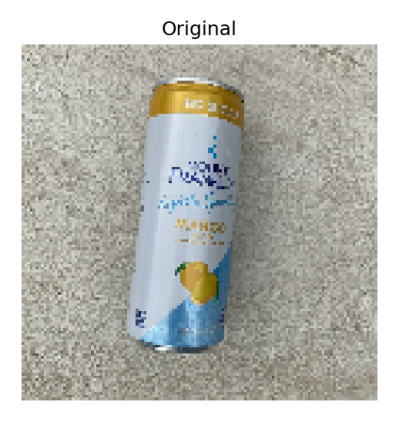

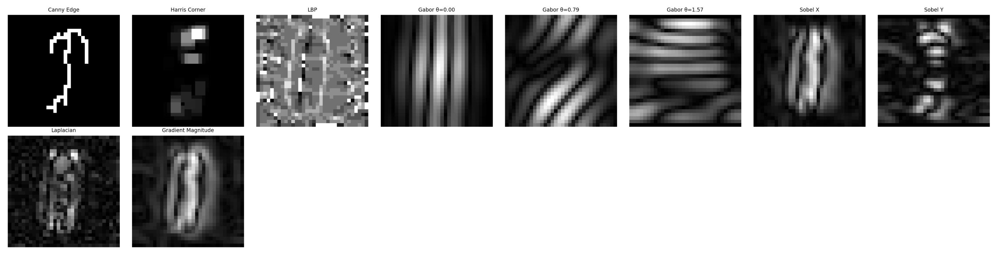

Epoch 15 Train Loss: 0.1793 | Train Acc : 0.9476 | Val Loss : 2.3546 | Val Acc : 0.4227


Epoch 16 Train Loss: 0.1093 | Train Acc : 0.9692 | Val Loss : 2.3790 | Val Acc : 0.4332


Epoch 17 Train Loss: 0.0787 | Train Acc : 0.9797 | Val Loss : 2.2567 | Val Acc : 0.4427


Epoch 18 Train Loss: 0.0589 | Train Acc : 0.9868 | Val Loss : 2.4701 | Val Acc : 0.4080


Epoch 19 Train Loss: 0.0426 | Train Acc : 0.9918 | Val Loss : 2.4370 | Val Acc : 0.4301


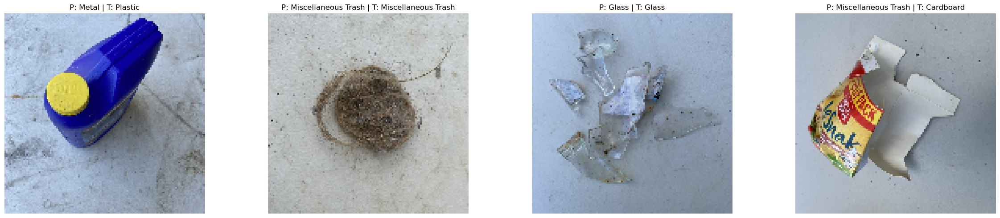

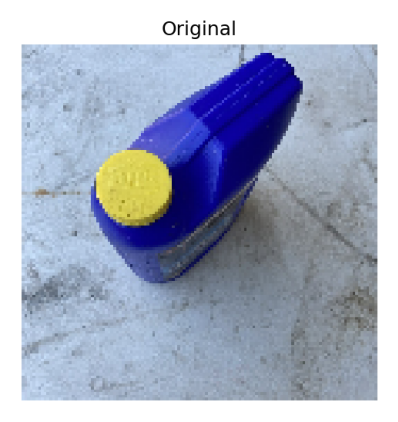

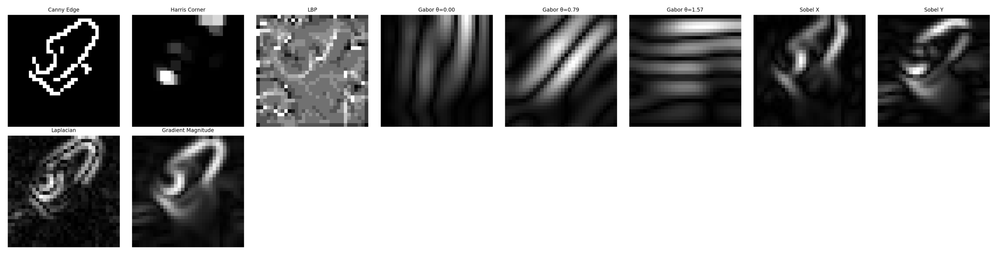

Epoch 20 Train Loss: 0.0337 | Train Acc : 0.9934 | Val Loss : 2.4626 | Val Acc : 0.4553


Epoch 21 Train Loss: 0.0297 | Train Acc : 0.9950 | Val Loss : 2.4825 | Val Acc : 0.4490


Epoch 22 Train Loss: 0.0434 | Train Acc : 0.9911 | Val Loss : 2.5347 | Val Acc : 0.4395


Epoch 23 Train Loss: 0.0697 | Train Acc : 0.9832 | Val Loss : 2.7692 | Val Acc : 0.4080


Epoch 24 Train Loss: 0.1337 | Train Acc : 0.9561 | Val Loss : 2.6193 | Val Acc : 0.4238


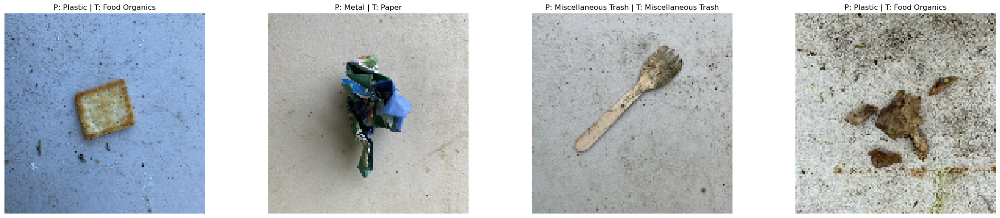

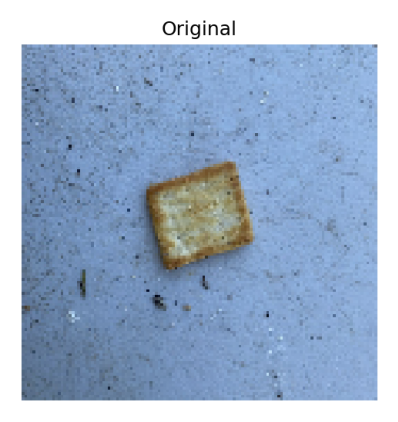

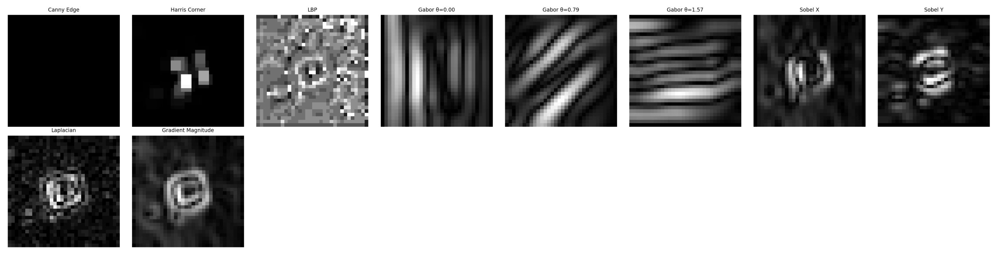

Epoch 25 Train Loss: 0.1235 | Train Acc : 0.9621 | Val Loss : 2.4424 | Val Acc : 0.4280


Epoch 26 Train Loss: 0.0930 | Train Acc : 0.9729 | Val Loss : 2.4575 | Val Acc : 0.4501


Epoch 27 Train Loss: 0.0757 | Train Acc : 0.9787 | Val Loss : 2.4660 | Val Acc : 0.4522


Epoch 28 Train Loss: 0.0510 | Train Acc : 0.9876 | Val Loss : 2.4995 | Val Acc : 0.4543


Epoch 29 Train Loss: 0.0484 | Train Acc : 0.9876 | Val Loss : 2.6459 | Val Acc : 0.4437


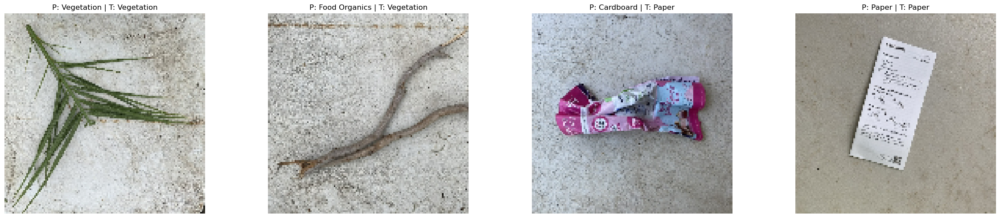

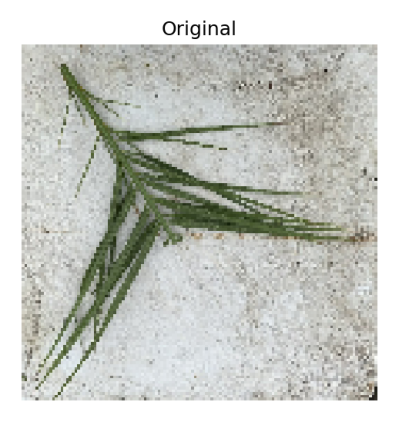

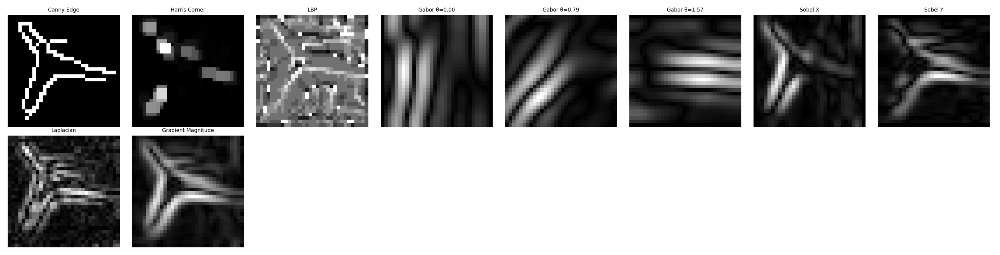

Epoch 30 Train Loss: 0.0453 | Train Acc : 0.9884 | Val Loss : 2.9470 | Val Acc : 0.4490


Epoch 31 Train Loss: 0.0533 | Train Acc : 0.9855 | Val Loss : 2.6072 | Val Acc : 0.4406


Epoch 32 Train Loss: 0.0613 | Train Acc : 0.9784 | Val Loss : 2.8343 | Val Acc : 0.4269


Epoch 33 Train Loss: 0.0616 | Train Acc : 0.9813 | Val Loss : 2.7298 | Val Acc : 0.4532


Epoch 34 Train Loss: 0.0679 | Train Acc : 0.9771 | Val Loss : 2.7271 | Val Acc : 0.4332


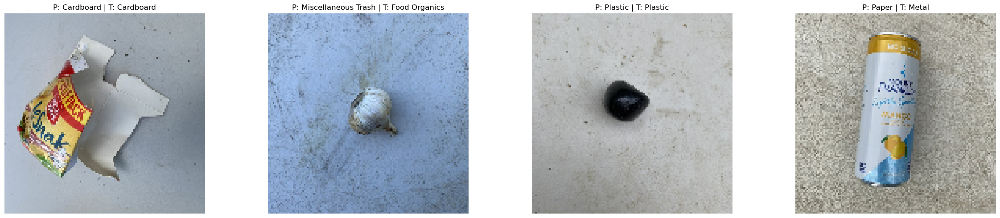

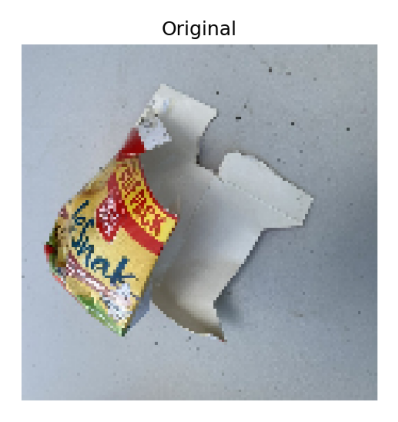

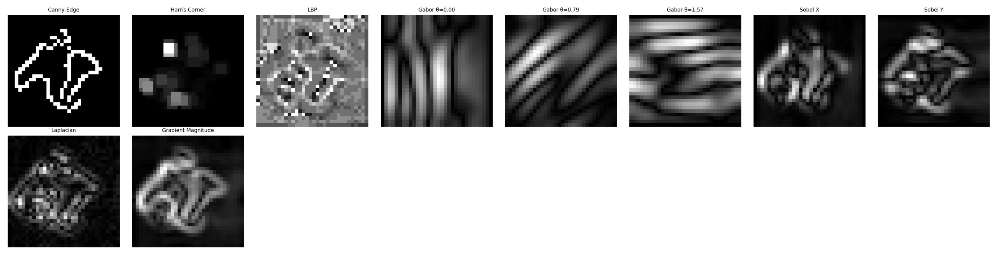

Epoch 35 Train Loss: 0.0731 | Train Acc : 0.9792 | Val Loss : 2.7195 | Val Acc : 0.4322


Epoch 36 Train Loss: 0.0706 | Train Acc : 0.9782 | Val Loss : 2.8662 | Val Acc : 0.4458


Epoch 37 Train Loss: 0.0638 | Train Acc : 0.9808 | Val Loss : 2.9418 | Val Acc : 0.4395


Epoch 38 Train Loss: 0.0547 | Train Acc : 0.9855 | Val Loss : 2.9050 | Val Acc : 0.3985


Epoch 39 Train Loss: 0.0439 | Train Acc : 0.9887 | Val Loss : 2.7536 | Val Acc : 0.4311


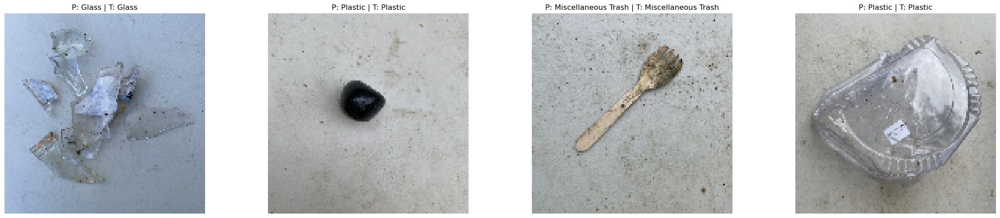

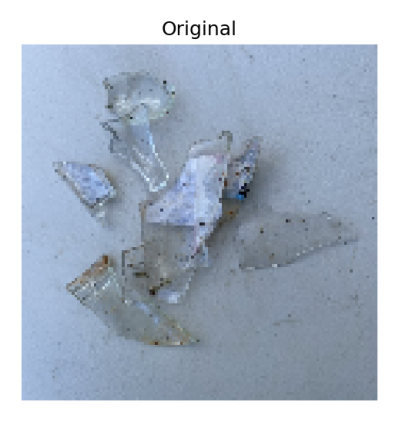

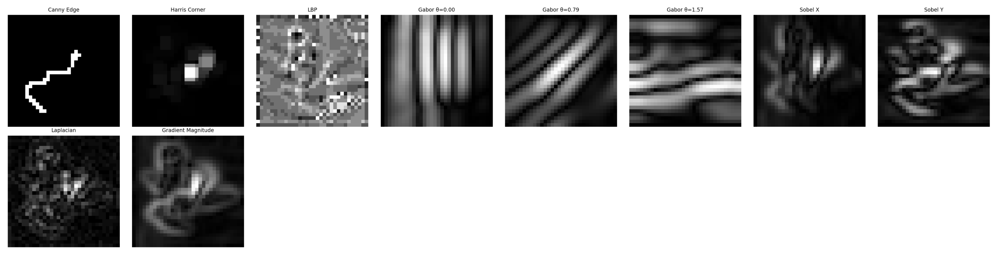

Epoch 40 Train Loss: 0.0423 | Train Acc : 0.9892 | Val Loss : 2.9664 | Val Acc : 0.4196


In [ ]:
for train_loss,train_acc,val_loss,val_acc,fig in classic_trainer.train(epochs=EPOCHS,visualize_every=VIS_EVERY):
    pass

In [ ]:
dt = time.time()-start_time
print(f"Training took {dt} seconds")

Training took 534.8437256813049 seconds


In [ ]:
classic_model.save(os.path.join('trained_model','classic_model.pt'))

Model saved to trained_model\classic_model.pt


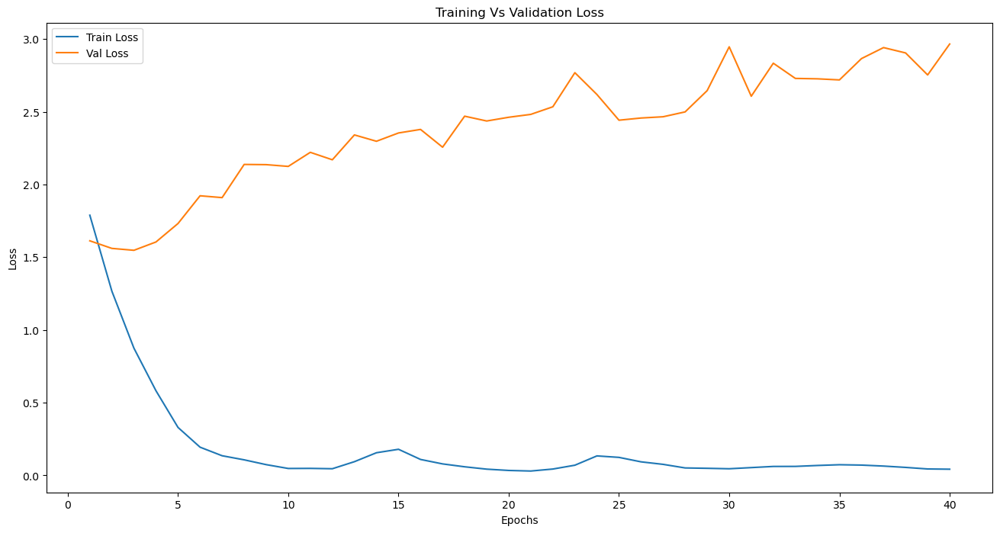

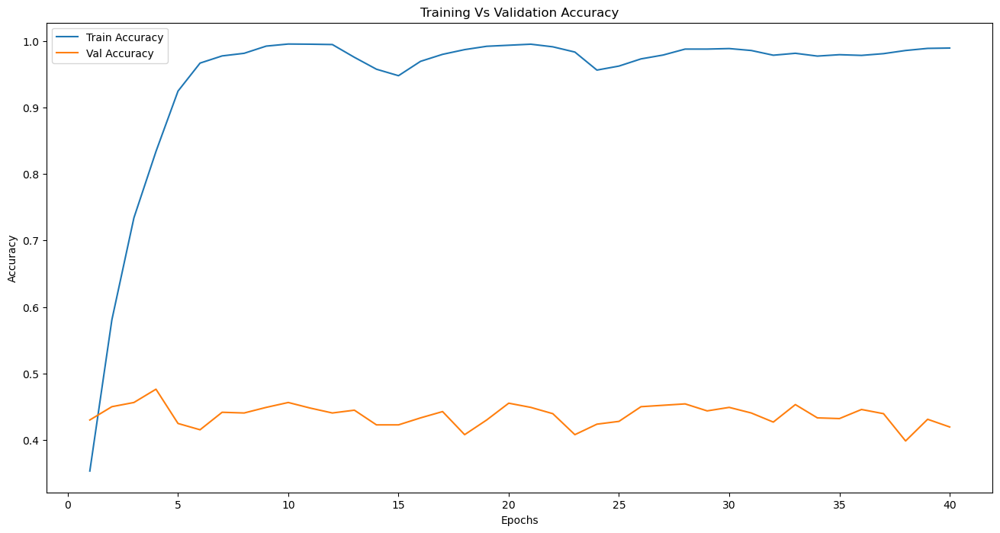

In [ ]:
plot([train_loss,val_loss],['Train Loss','Val Loss'],'Epochs','Loss','Training Vs Validation Loss')
plot([train_acc,val_acc],['Train Accuracy','Val Accuracy'],'Epochs','Accuracy','Training Vs Validation Accuracy')